In [40]:
import cv2
import numpy as np
import dlib
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [55, 50]



In [65]:
def rect_to_bb(rect):
    # Dlib rect --> OpenCV rect
    x = rect.left()
    y = rect.top()
    w = rect.right() - x
    h = rect.bottom() - y

    return (x, y, w, h)


def faces(image, factor):
    #open original image
    img = cv2.imread(image)
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #show origin image
    #plt.subplot(121), plt.imshow(img)

    #load dlib detector
    detector = dlib.get_frontal_face_detector()

    #detect faces
    rects = detector(gray, factor)

    # Draw rectangle around each face
    result_dlib = np.copy(img)
    faces_dlib_img = []
    for rect in rects:    
        x, y, w, h = rect_to_bb(rect)
        #get random color
        color = list(np.random.random(size=3) * 255)
        cv2.rectangle(result_dlib, (x, y), (x+w, y+h), color, 3)
        faces_dlib_img.append(img[y:y+h, x:x+w, :])
    
    #show image with rectangles 
    plt.subplot(122), plt.imshow(result_dlib), plt.title('dlib')

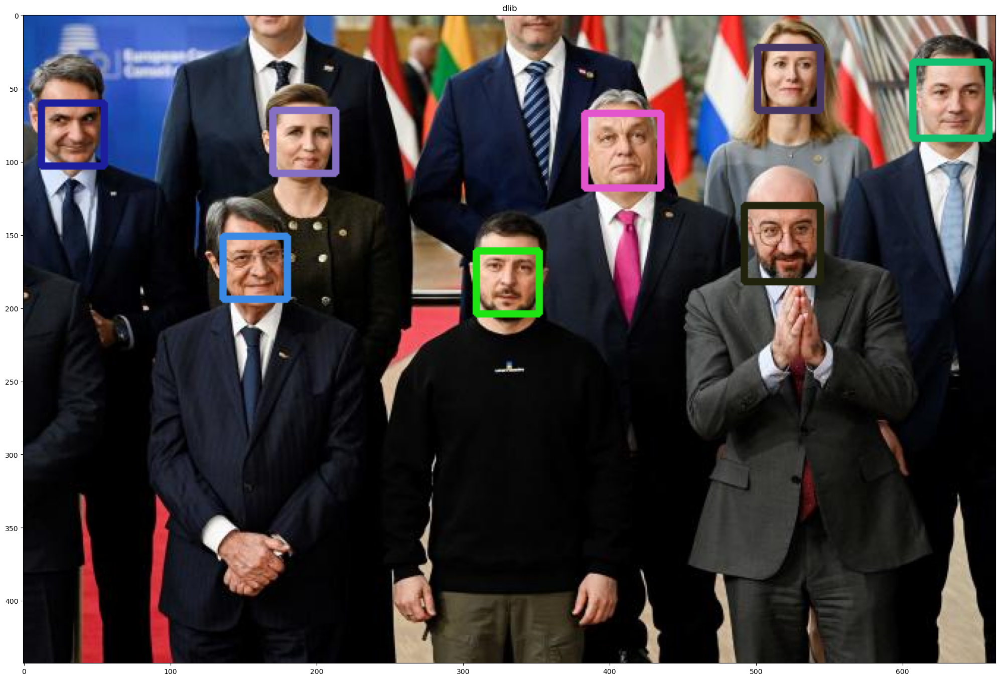

In [66]:
faces('eu_summit.jpg',1)


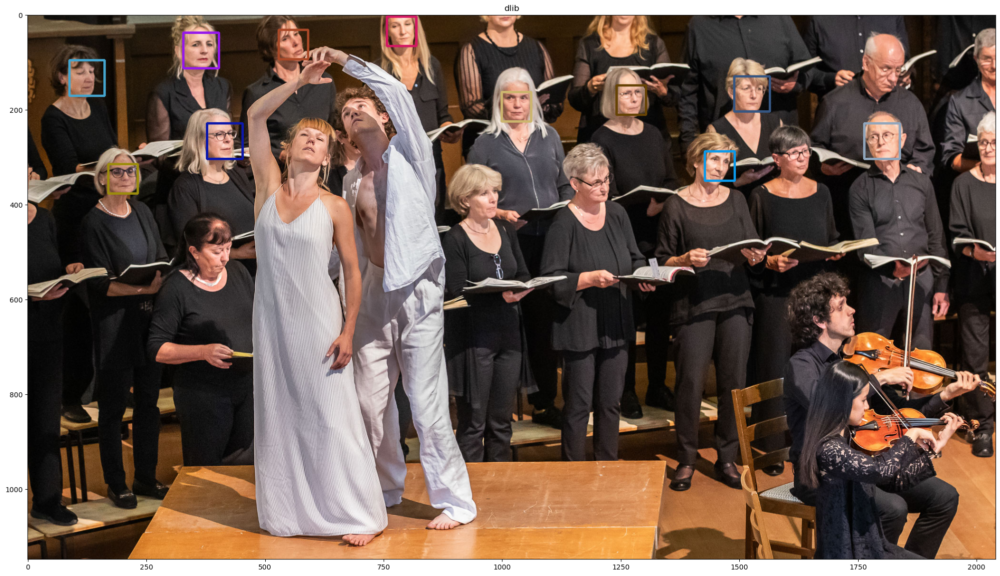

In [68]:
faces('Laudatechor-Thun-13.jpg',1)

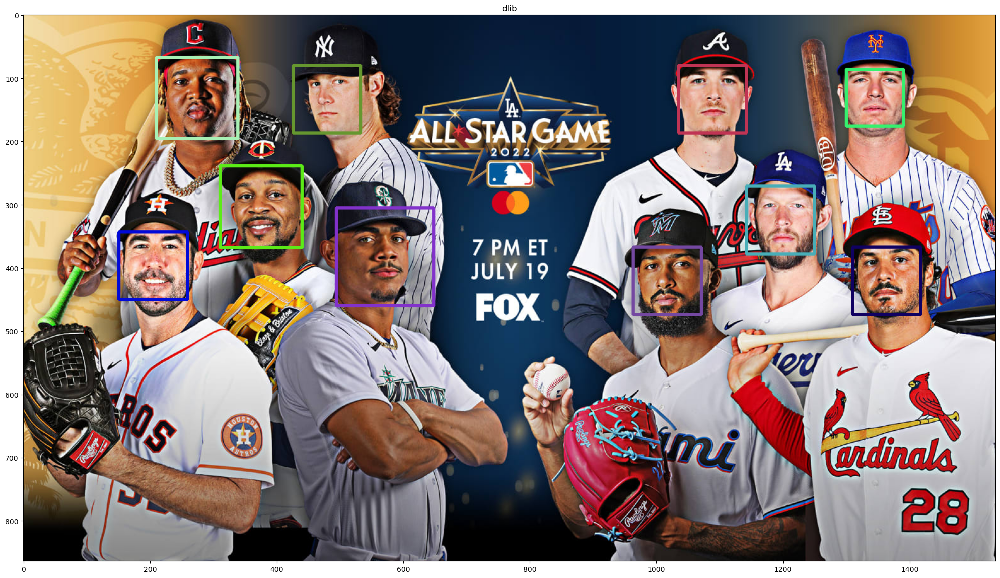

In [53]:
faces('baseball_team.jpg')

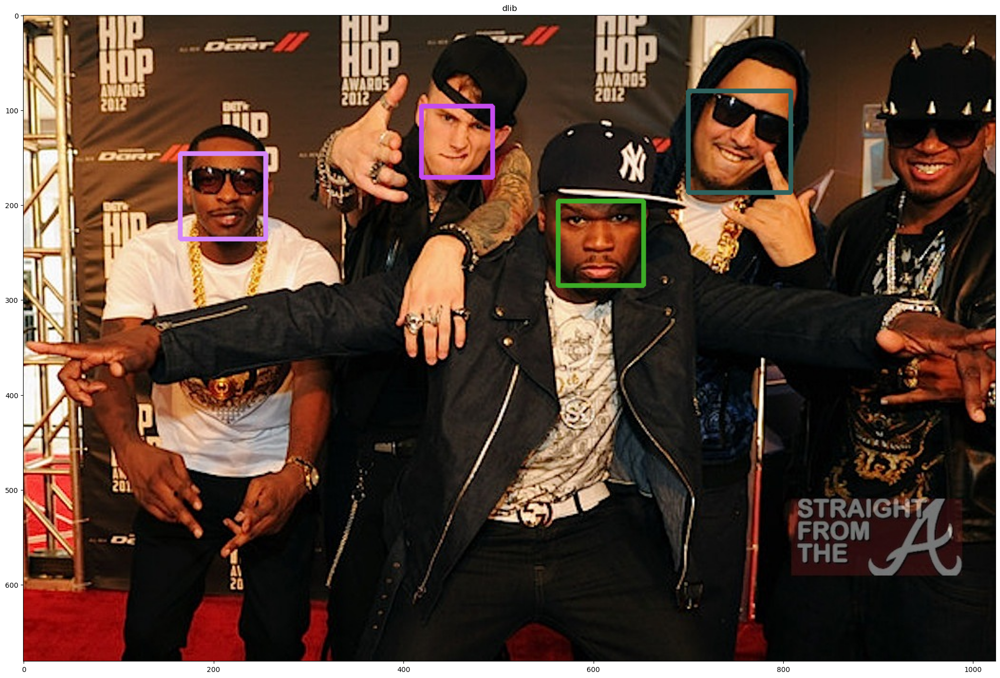

In [69]:
faces('Hip-Hop-Awards.jpg', 1)

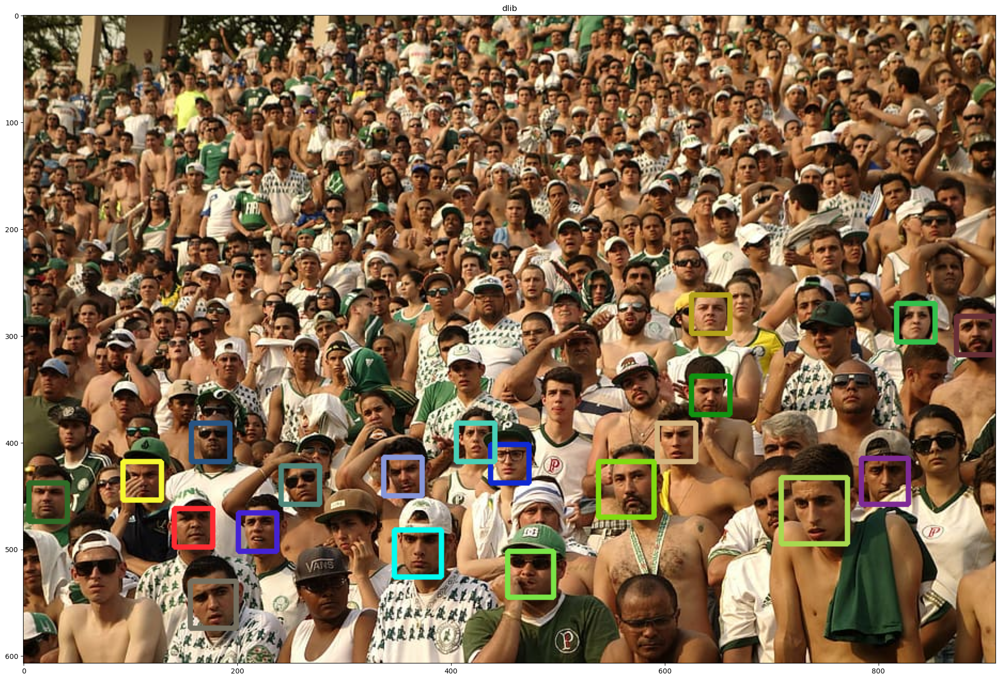

In [70]:
faces('football-twisted-stadium-fans.jpg',1)

How does the detector perform? - I would say good enough if we try to detect  "big" faces which look straight to the camera.  
Is it robust? - With a "big" faces - yes, with "small" faces in the crowd - no (we can see it on the last two pictures).

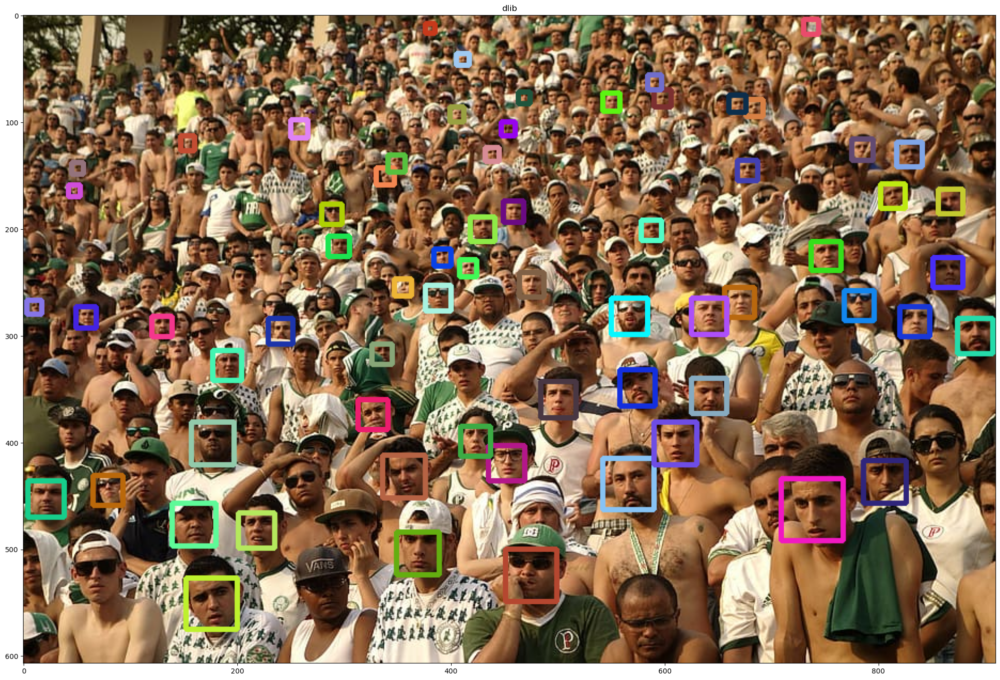

In [72]:
#try upsampling factor 4
faces('football-twisted-stadium-fans.jpg',4)